# This notebook is for showing the cleaning process using Pandas

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px

In [2]:
# create the data frame from the csv file
df = pd.read_csv('../data/202212-divvy-tripdata.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181806 entries, 0 to 181805
Data columns (total 13 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   ride_id             181806 non-null  object 
 1   rideable_type       181806 non-null  object 
 2   started_at          181806 non-null  object 
 3   ended_at            181806 non-null  object 
 4   start_station_name  152523 non-null  object 
 5   start_station_id    152523 non-null  object 
 6   end_station_name    150648 non-null  object 
 7   end_station_id      150648 non-null  object 
 8   start_lat           181806 non-null  float64
 9   start_lng           181806 non-null  float64
 10  end_lat             181678 non-null  float64
 11  end_lng             181678 non-null  float64
 12  member_casual       181806 non-null  object 
dtypes: float64(4), object(9)
memory usage: 18.0+ MB


In [3]:
df.head()

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
0,65DBD2F447EC51C2,electric_bike,2022-12-05 10:47:18,2022-12-05 10:56:34,Clifton Ave & Armitage Ave,TA1307000163,Sedgwick St & Webster Ave,13191,41.918244,-87.657115,41.922167,-87.638888,member
1,0C201AA7EA0EA1AD,classic_bike,2022-12-18 06:42:33,2022-12-18 07:08:44,Broadway & Belmont Ave,13277,Sedgwick St & Webster Ave,13191,41.940106,-87.645451,41.922167,-87.638888,casual
2,E0B148CCB358A49D,electric_bike,2022-12-13 08:47:45,2022-12-13 08:59:51,Sangamon St & Lake St,TA1306000015,St. Clair St & Erie St,13016,41.885919,-87.651133,41.894345,-87.622798,member
3,54C5775D2B7C9188,classic_bike,2022-12-13 18:50:47,2022-12-13 19:19:48,Shields Ave & 31st St,KA1503000038,Damen Ave & Madison St,13134,41.838464,-87.635406,41.881370,-87.674930,member
4,A4891F78776D35DF,classic_bike,2022-12-14 16:13:39,2022-12-14 16:27:50,Ashland Ave & Chicago Ave,13247,Damen Ave & Charleston St,13288,41.895954,-87.667728,41.920082,-87.677855,casual


In [4]:
df['started_at'] = pd.to_datetime(df['started_at'])
df['ended_at'] = pd.to_datetime(df['ended_at'])
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181806 entries, 0 to 181805
Data columns (total 13 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   ride_id             181806 non-null  object        
 1   rideable_type       181806 non-null  object        
 2   started_at          181806 non-null  datetime64[ns]
 3   ended_at            181806 non-null  datetime64[ns]
 4   start_station_name  152523 non-null  object        
 5   start_station_id    152523 non-null  object        
 6   end_station_name    150648 non-null  object        
 7   end_station_id      150648 non-null  object        
 8   start_lat           181806 non-null  float64       
 9   start_lng           181806 non-null  float64       
 10  end_lat             181678 non-null  float64       
 11  end_lng             181678 non-null  float64       
 12  member_casual       181806 non-null  object        
dtypes: datetime64[ns](2), float64

In [5]:
df.dropna(subset=['end_lat'], inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 181678 entries, 0 to 181805
Data columns (total 13 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   ride_id             181678 non-null  object        
 1   rideable_type       181678 non-null  object        
 2   started_at          181678 non-null  datetime64[ns]
 3   ended_at            181678 non-null  datetime64[ns]
 4   start_station_name  152395 non-null  object        
 5   start_station_id    152395 non-null  object        
 6   end_station_name    150648 non-null  object        
 7   end_station_id      150648 non-null  object        
 8   start_lat           181678 non-null  float64       
 9   start_lng           181678 non-null  float64       
 10  end_lat             181678 non-null  float64       
 11  end_lng             181678 non-null  float64       
 12  member_casual       181678 non-null  object        
dtypes: datetime64[ns](2), float64(4), 

In [6]:
# After cleaning the latitude and longitue and formatting started_at and ended_at as datetime values, a column for duration of trips is required
df['trip_time'] = round((df['ended_at'] - df['started_at']).dt.total_seconds()/60,2)
df.head(100)

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual,trip_time
0,65DBD2F447EC51C2,electric_bike,2022-12-05 10:47:18,2022-12-05 10:56:34,Clifton Ave & Armitage Ave,TA1307000163,Sedgwick St & Webster Ave,13191,41.918244,-87.657115,41.922167,-87.638888,member,9.27
1,0C201AA7EA0EA1AD,classic_bike,2022-12-18 06:42:33,2022-12-18 07:08:44,Broadway & Belmont Ave,13277,Sedgwick St & Webster Ave,13191,41.940106,-87.645451,41.922167,-87.638888,casual,26.18
2,E0B148CCB358A49D,electric_bike,2022-12-13 08:47:45,2022-12-13 08:59:51,Sangamon St & Lake St,TA1306000015,St. Clair St & Erie St,13016,41.885919,-87.651133,41.894345,-87.622798,member,12.10
3,54C5775D2B7C9188,classic_bike,2022-12-13 18:50:47,2022-12-13 19:19:48,Shields Ave & 31st St,KA1503000038,Damen Ave & Madison St,13134,41.838464,-87.635406,41.881370,-87.674930,member,29.02
4,A4891F78776D35DF,classic_bike,2022-12-14 16:13:39,2022-12-14 16:27:50,Ashland Ave & Chicago Ave,13247,Damen Ave & Charleston St,13288,41.895954,-87.667728,41.920082,-87.677855,casual,14.18
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,1BDA4422E3174270,electric_bike,2022-12-10 18:18:40,2022-12-10 18:28:14,Clark St & Elm St,TA1307000039,St. Clair St & Erie St,13016,41.902723,-87.631835,41.894345,-87.622798,member,9.57
96,1E65A6163D514976,classic_bike,2022-12-28 08:58:21,2022-12-28 09:10:23,Clark St & Elm St,TA1307000039,Wacker Dr & Washington St,KA1503000072,41.902973,-87.631280,41.883143,-87.637242,member,12.03
97,9161B3FC5044FE41,electric_bike,2022-12-11 06:27:18,2022-12-11 06:31:26,Clark St & Elm St,TA1307000039,St. Clair St & Erie St,13016,41.902714,-87.631649,41.894345,-87.622798,member,4.13
98,A08694E1DCC8DD80,classic_bike,2022-12-27 13:33:45,2022-12-27 13:40:29,Clark St & Elm St,TA1307000039,St. Clair St & Erie St,13016,41.902973,-87.631280,41.894345,-87.622798,member,6.73


In [7]:
# basic statistics for each attribute of each trip
df.describe()

,started_at,ended_at,start_lat,start_lng,end_lat,end_lng,trip_time
count,181678,181678,181678.000000,181678.000000,181678.000000,181678.000000,181678.000000
mean,2022-12-13 10:22:05.829710080,2022-12-13 10:33:12.195032320,41.900821,-87.649290,41.900935,-87.649396,11.106078
min,2022-12-01 00:01:22,2022-12-01 00:03:41,41.648501,-87.830000,41.640000,-87.840000,0.000000
25%,2022-12-06 13:04:59,2022-12-06 13:14:54.249999872,41.880000,-87.663760,41.880000,-87.663913,4.550000
50%,2022-12-11 17:00:25.500000,2022-12-11 17:15:13,41.896373,-87.645451,41.896373,-87.645991,7.450000
75%,2022-12-19 13:18:00,2022-12-19 13:29:05.500000,41.929694,-87.630876,41.930000,-87.630834,12.480000
max,2022-12-31 23:59:26,2023-01-01 18:09:37,42.070000,-87.528232,42.070000,-87.520000,1499.930000
std,NaN,NaN,0.046212,0.028244,0.046274,0.028326,24.309672


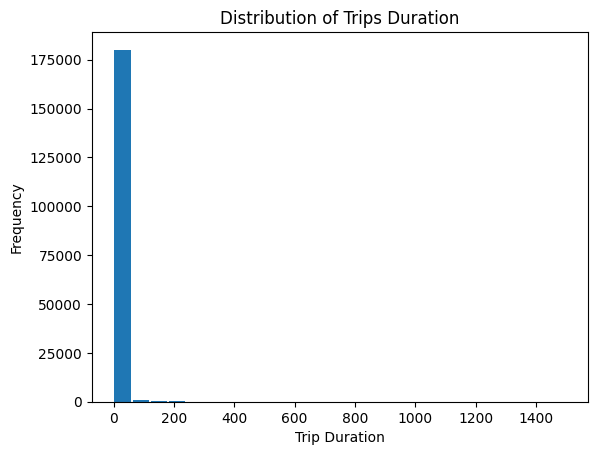

In [8]:
plt.hist(df['trip_time'], rwidth=0.9, bins=25)
plt.xlabel('Trip Duration')
plt.ylabel('Frequency')
plt.title('Distribution of Trips Duration');

In [9]:
px.histogram(df, x='trip_time')

In [10]:
px.box(df, x='trip_time')

Based on the data distribution, 75% of all trips fall under a time duration of 12.48 minutes per trip, with the median in 7.45 minutes per trip. However, we can see that there are some outliers because the upper limit was calculated in around 24.37 minutes for the longer trips and we found some trips longer than 1000 minutes (more than 16 hours of traveling). This can be due to late returns of the bicycles.

### Where are the bikes rented the most?
Here we want to find out which are the location with more bikes rented for the whole year

In [13]:
fig = px.scatter_mapbox(df, lat='start_lat', lon='start_lng',width=800, height=800, hover_data=["trip_time"],color="trip_time",size="trip_time",color_continuous_scale=px.colors.sequential.Rainbow)
fig.update_layout(mapbox_style="open-street-map")
fig.show()

We can see that most of the rides are taken around the Northwestern University of Chicago campus, the Chicago Police Marine Heliport and the University of Illinois Chicago, with some of the longest trips concentrated around this areas. This gives us an idea that maybe some of the more frequent riders are students or even university staff trying to reduce commute costs or time